**Colab 3: trippy**

In this colab we'll download a pre-trained image classification network and dig into it.  We'll implement our own 'deep dream', to hallucinate visual features using it.

In [1]:
import tensorflow as tf
import numpy as np
import matplotlib.pyplot as plt
%matplotlib inline
import tensorflow_datasets as tfds
import scipy.ndimage as nim
tfkl = tf.keras.layers

tf.compat.v1.logging.set_verbosity(tf.compat.v1.logging.ERROR)

tf.config.list_physical_devices()

[PhysicalDevice(name='/physical_device:CPU:0', device_type='CPU')]

In [2]:
# There are many downloadable pre-trained models, which are great to use as
# a starting point before fine tuning the weights on some new task

# Resnet is a famous one with residual connections which allowed it to be deeper
# than others before it
resnet = tf.keras.applications.ResNet50V2()
print(resnet.summary())

102875136/102869336 [==============================] - 1s 0us/step
Model: "resnet50v2"
__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
input_1 (InputLayer)            [(None, 224, 224, 3) 0                                            
__________________________________________________________________________________________________
conv1_pad (ZeroPadding2D)       (None, 230, 230, 3)  0           input_1[0][0]                    
__________________________________________________________________________________________________
conv1_conv (Conv2D)             (None, 112, 112, 64) 9472        conv1_pad[0][0]                  
__________________________________________________________________________________________________
pool1_pad (ZeroPadding2D)       (None, 114, 114, 64) 0           conv1_conv[0][0]                 
______________________

First conv layer weights shape: (7, 7, 3, 64)


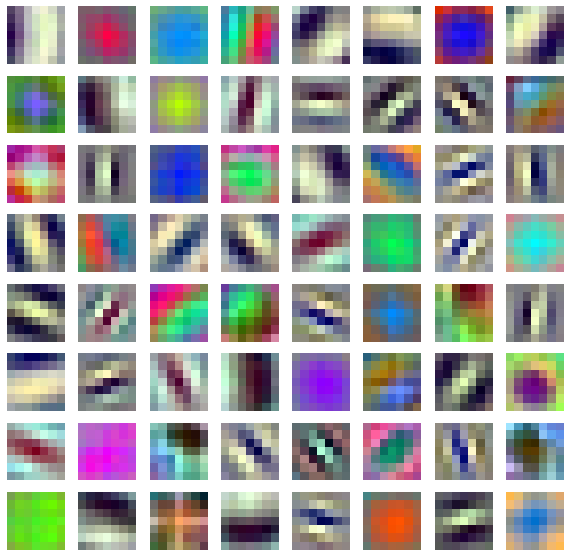

In [8]:
# There are 64 kernels in the first conv layer; let's plot them
first_conv_layer = resnet.layers[2]
kernel_weights = first_conv_layer.weights[0]
print("First conv layer weights shape:", kernel_weights.shape)

plt.figure(figsize=(10, 10))
for kernel_id in range(kernel_weights.shape[-1]):
  kernel = np.float32(kernel_weights[..., kernel_id])
  # For displaying the kernels, normalize the vals to be between 0 and 1
  kernel = (kernel - kernel.min()) / (kernel.max() - kernel.min())
  plt.subplot(8, 8, kernel_id+1)
  plt.imshow(kernel)
  plt.axis('off')
plt.show()

Dl Completed...: 0 url [00:00, ? url/s]

Dl Size...: 0 MiB [00:00, ? MiB/s]

Extraction completed...: 0 file [00:00, ? file/s]

0 examples [00:00, ? examples/s]

Shuffling and writing examples to /root/tensorflow_datasets/imagenet_v2/matched-frequency/1.0.0.incomplete9TGRFO/imagenet_v2-test.tfrecord


  0%|          | 0/10000 [00:00<?, ? examples/s]

Dataset imagenet_v2 downloaded and prepared to /root/tensorflow_datasets/imagenet_v2/matched-frequency/1.0.0. Subsequent calls will reuse this data.


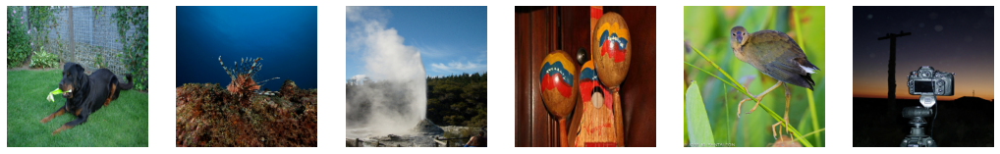

In [10]:
# Let's get some interesting pics (same ones from last week) to 
# probe how the network "sees" them

# For some reason I always have to run this tfds.load call twice; the first time
# complains about a checksum mismatch, but the second time is fine
sample_dset = tfds.load('imagenet_v2', split='test', as_supervised=True)
sample_dset = sample_dset.map(lambda image, _: tf.image.convert_image_dtype(image, tf.float32))

# Grab a couple of pics with decent color ranges
curated_image_inds = [2, 3, 10, 35, 42, 54]
sample_images = []
for image_ind, image in enumerate(sample_dset.take(75)):
  if image_ind in curated_image_inds:
    sample_images.append(tf.image.resize(image, [224, 224]))
sample_images = tf.stack(sample_images, 0)

plt.figure(figsize=(18, 3))
for image_ind in range(6):
  plt.subplot(1, 6, image_ind+1)
  plt.imshow(sample_images[image_ind])
  plt.axis('off')
plt.show()

In [ ]:
# We can pass the images through the conv layer directly
conv_outputs = #TODO pass the sample images through the conv layer
print('Output from first conv layer:', conv_outputs.shape[1:])

In [ ]:
# Let's visualize each of these channels, which are the convolution of the image with the corresponding [7, 7, 3] kernel
num_kernels_to_display = 16
inches_per_subplot = 3
num_images = sample_images.shape[0]

for kernel_id in range(num_kernels_to_display):
  plt.figure(figsize=((num_images+1)*inches_per_subplot, inches_per_subplot))
  plt.subplot(1, num_images+1, 1)
  kernel = np.float32(kernel_weights[..., kernel_id])
  kernel = (kernel - kernel.min()) / (kernel.max() - kernel.min())
  plt.imshow(kernel)
  plt.axis('off')
  plt.title(f'Kernel {kernel_id}', fontsize=16)
  for image_id in range(num_images):
    plt.subplot(1, num_images+1, image_id+2)
    plt.imshow(#TODO grab the activation map corresponding to the image_id and kernel_id)
    plt.axis('off')
  plt.show()

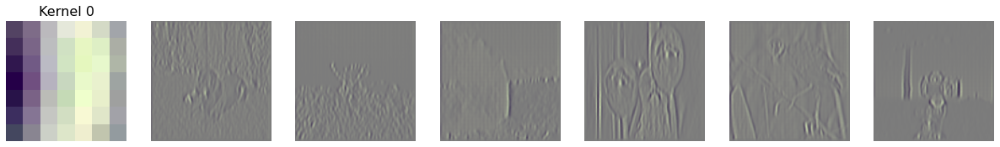

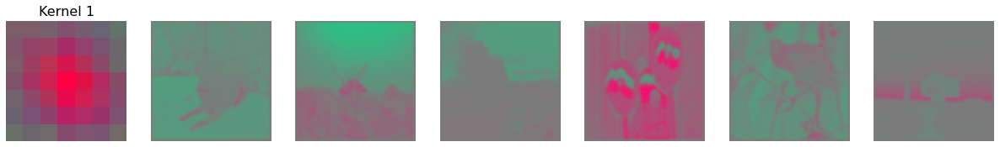

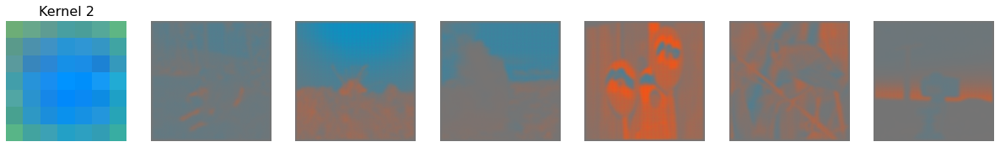

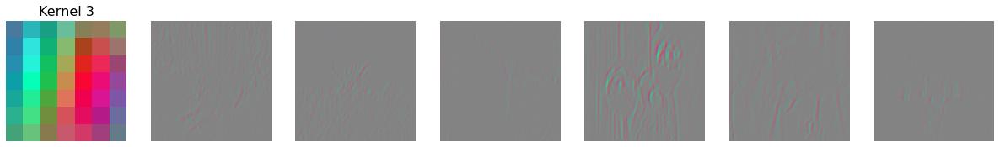

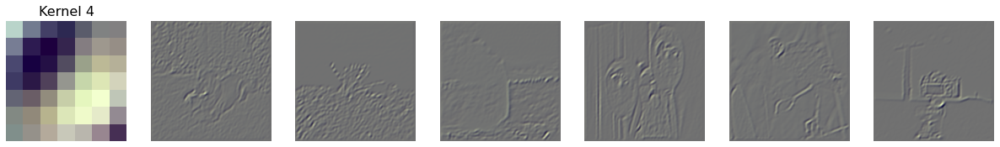

...

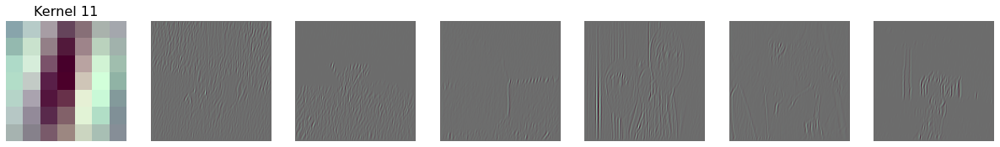

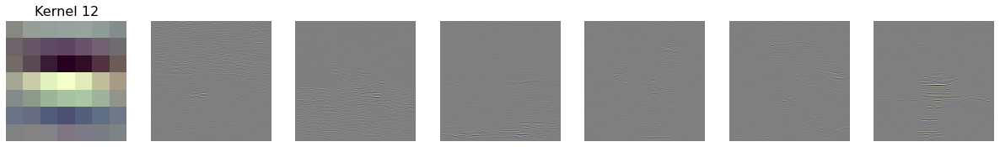

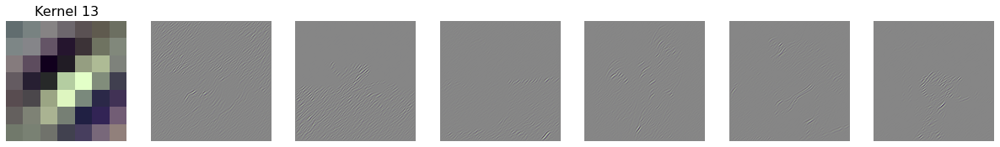

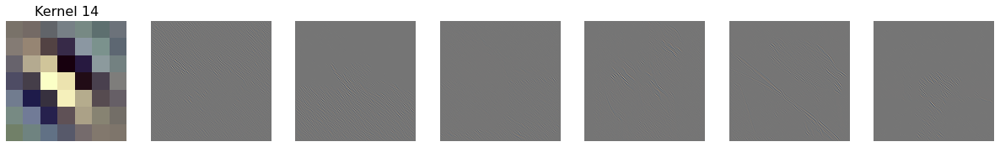

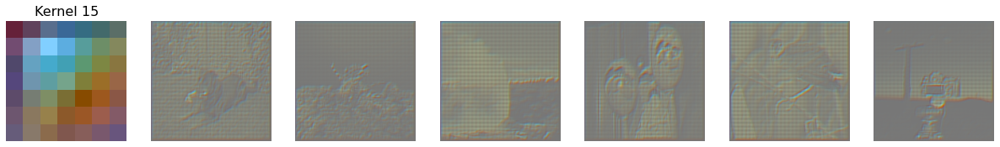

In [25]:
# All right, fasten your seat belt, we're going to compute gradients of the 
# activation with respect to the input image pixel values

# To do so, we first need to turn the images into a tf.Variable so that it's
# automatically tracked by tensorflow's GradientTape
sample_images = tf.Variable(sample_images)

num_kernels_to_display = 16
inches_per_subplot = 3
num_images = sample_images.shape[0]

for kernel_id in range(num_kernels_to_display):
  # Just display the kernel as we've been doing
  kernel = np.float32(kernel_weights[..., kernel_id])
  kernel = (kernel - kernel.min()) / (kernel.max() - kernel.min())
  plt.figure(figsize=(21, 3))
  plt.subplot(1, num_images+1, 1)
  plt.imshow(kernel)
  plt.axis('off')
  plt.title(f'Kernel {kernel_id}', fontsize=16)
  # Now keep track of gradients
  with tf.GradientTape() as tape:
    kernel_activation = tf.square(first_conv_layer(sample_images)[..., kernel_id])
    kernel_activation = tf.reduce_sum(kernel_activation)
  # This computes the gradient of the first argument with respect to the second
  grads = tape.gradient(kernel_activation, sample_images)
  grads = np.float32(grads)
  # Note the gradient is the same size as the input image, and the color of the gradient is relevant
  # Similarly normalize the gradients for visualization
  grads = (grads - grads.min()) / (grads.max() - grads.min())
  for image_id in range(num_images):
    plt.subplot(1, num_images+1, image_id+2)
    plt.imshow(grads[image_id])
    plt.axis('off')
  plt.show()

In [16]:
# We are going to dig into more than the first layer, so let's make a new (full) keras model with a subset of the layers
# It's easily defined using the input to the resnet and the output of one of the layers
# For simplicity, let's only consider the conv layers of the resnet
# The names of the layers are descriptive so we can just look for 'conv' as the last four letters
conv_inds = np.where([l.name[-4:]=='conv' for l in resnet.layers])[0]
print("Indices of conv layers:", conv_inds)

Indices of conv layers: [  2   7  11  14  15  19  23  26  30  34  38  42  46  49  50  54  58  61
  65  69  72  76  80  84  88  92  95  96 100 104 107 111 115 118 122 126
 129 133 137 140 144 148 152 156 160 163 164 168 172 175 179 183 186]


In [17]:
# Earlier laters focus on simpler (and generally more interpretable) features
layer_id = 23
# This is different than how we were creating models before, with tf.keras.Sequential
# Here you just hand an input tensor and an output tensor, which is much more customizable
mini_model = tf.keras.Model(resnet.input, resnet.layers[layer_id].output)
mini_model.summary()

Model: "model_1"
__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
input_1 (InputLayer)            [(None, 224, 224, 3) 0                                            
__________________________________________________________________________________________________
conv1_pad (ZeroPadding2D)       (None, 230, 230, 3)  0           input_1[0][0]                    
__________________________________________________________________________________________________
conv1_conv (Conv2D)             (None, 112, 112, 64) 9472        conv1_pad[0][0]                  
__________________________________________________________________________________________________
pool1_pad (ZeroPadding2D)       (None, 114, 114, 64) 0           conv1_conv[0][0]                 
____________________________________________________________________________________________

Intermediate output shape: (56, 56, 64)


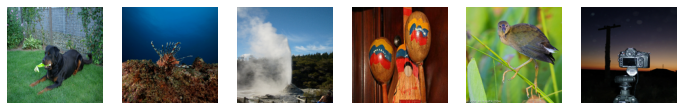

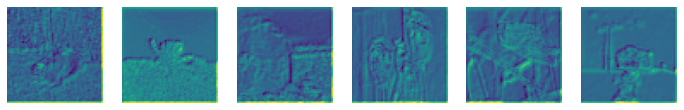

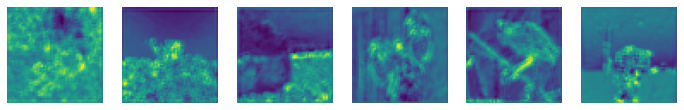

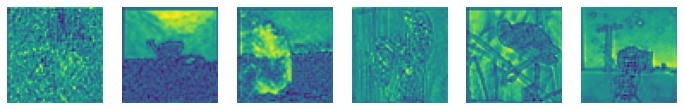

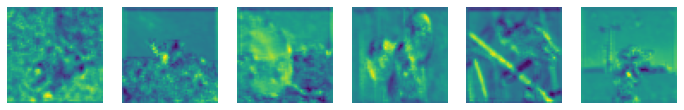

...

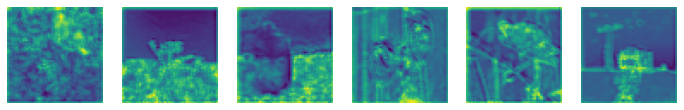

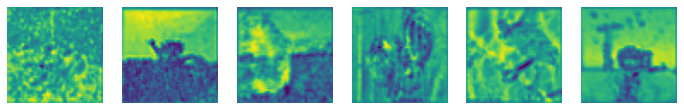

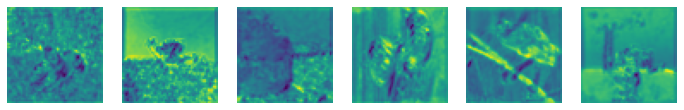

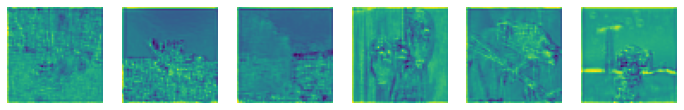

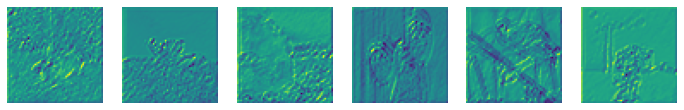

In [21]:
# We can still visualize the activation maps, one per kernel/channel
# Though now the kernels themselves are not informative so we won't display them
intermed_outp = mini_model(sample_images)
print('Intermediate output shape:', intermed_outp.shape[1:])
inches_per_subplot = 2
num_images = sample_images.shape[0]
num_kernels_to_display = 16

plt.figure(figsize=(num_images*inches_per_subplot, inches_per_subplot))
for image_id in range(num_images):
  plt.subplot(1, num_images, image_id+1)
  plt.imshow(sample_images[image_id])
  plt.axis('off')
plt.show()
for kernel_id in range(num_kernels_to_display):
  plt.figure(figsize=(num_images*inches_per_subplot, inches_per_subplot))
  for image_id in range(num_images):
    plt.subplot(1, num_images, image_id+1)
    image = np.float32(intermed_outp[image_id, ..., kernel_id])
    image = (image - image.min()) / (image.max() - image.min())
    plt.imshow(image)
    plt.axis('off')
  plt.show()

In [ ]:
# What are the gradients with respect to these later activations?
sample_images = tf.Variable(sample_images)

inches_per_subplot = 3
num_images = sample_images.shape[0]
num_kernels_to_display = 16

for kernel_id in range(num_kernels_to_display):
  with tf.GradientTape() as tape:
    # TODO compute the kernel activation for the particular kernel_id, due to the sample images
  grads = np.float32(tape.gradient(kernel_activation, sample_images))
  plt.figure(figsize=(num_images*inches_per_subplot, inches_per_subplot))
  for image_id in range(num_images):
    plt.subplot(1, num_images, image_id+1)
    grad_image = grads[image_id]
    grad_image = (grad_image - grad_image.min()) / (grad_image.max() - grad_image.min())
    plt.imshow(grad_image)
    plt.axis('off')
  plt.show()

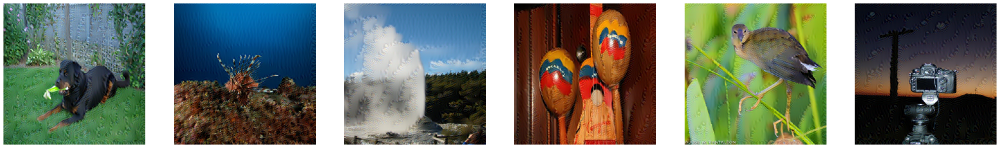

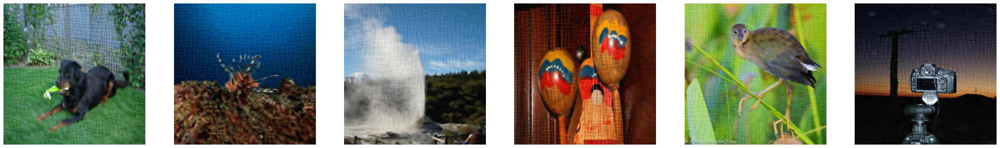

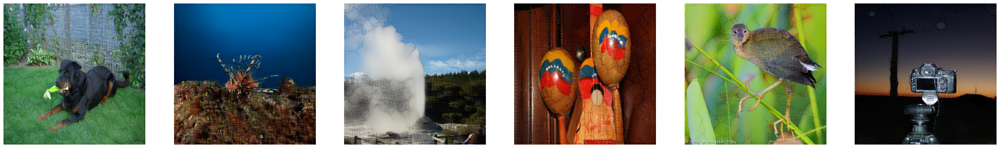

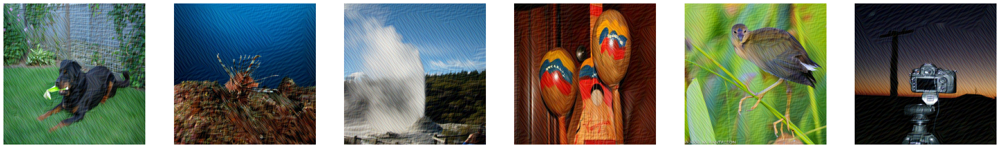

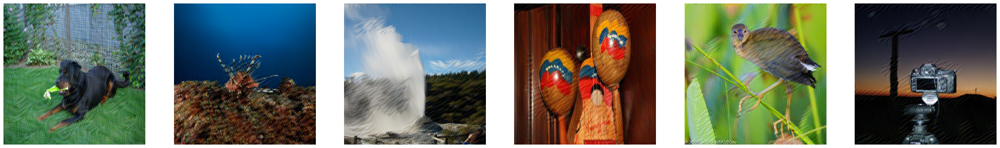

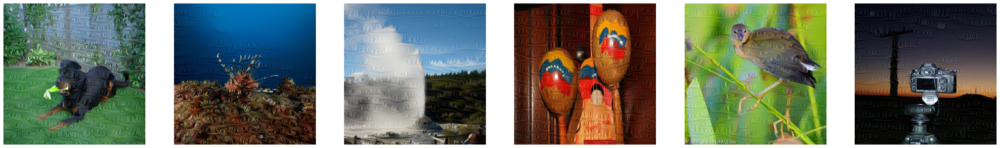

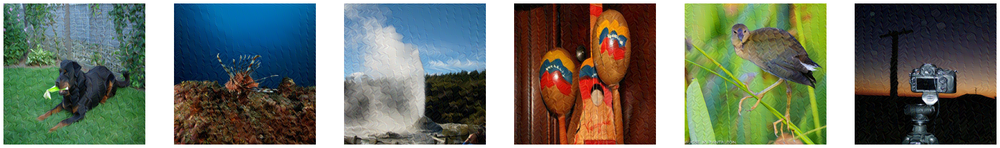

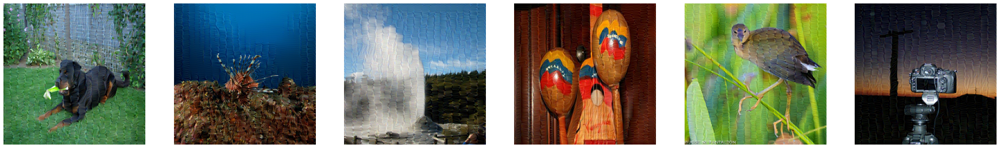

In [24]:
# What if we adjusted the original pixels in the direction of these gradients?
# And then, recompute the gradients and adjust the new image to maximize a specific activation

# We'll do a little better and use an adaptive optimizer (rather than just adding the gradients directly to the image)
# Also rather than just boosting the activation values, we want the spread to be
# boosted so that it's a little more clear what parts of the image are being boosted
# (but definitely mess around with all of this, and let me know if you find anything that works particularly well)

update_size = 5e-4  # really just the learning rate
num_perturb_steps = 100
moment = 2
num_kernels_to_display = 8
num_images = sample_images.shape[0]
inches_per_subplot = 6

for kernel_id in range(num_kernels_to_display):
  # Start back at the original images for each kernel
  sample_images_adjusted = tf.Variable(sample_images)
  opt = tf.keras.optimizers.Adam(update_size)
  for _ in range(num_perturb_steps):
    with tf.GradientTape() as tape:
      kernel_activation = mini_model(sample_images_adjusted)[..., kernel_id]
      # Flatten the activation map to compute its variance or whatever
      kernel_activation = tf.reshape(kernel_activation, [num_images, -1])
      loss = -tf.reduce_sum(
          tf.reduce_mean(tf.pow(kernel_activation, moment), axis=-1) - tf.pow(tf.reduce_mean(kernel_activation, axis=-1), moment)
          )
    grads = np.float32(tape.gradient(loss, sample_images_adjusted))
    opt.apply_gradients(zip([grads], [sample_images_adjusted]))
    # Clip the image to keep the RGB values between 0 and 1 (so that nothing blows up or leaves the range of values that the network was trained on)
    # It's a tf.Variable so we have to assign it rather than =
    sample_images_adjusted.assign(tf.clip_by_value(sample_images_adjusted, 0., 1.))
  plt.figure(figsize=(num_images*inches_per_subplot, num_images))
  for image_id in range(num_images):
    plt.subplot(1, num_images, image_id+1)
    plt.imshow(sample_images_adjusted[image_id])
    plt.axis('off')
  plt.show()

In [ ]:
# Try this with a later layer (which should pick up on more complex patterns)
# Try it with different update sizes/learning rates (too high and things get weird real quick)
# The moment also gives different behavior, try even/odd and low/high 
## Adjust all of these #########################################################
layer_id = 88

update_size = 5e-4
num_perturb_steps = 100
moment = 2
################################################################################

mini_mod = tf.keras.Model(resnet.input, resnet.layers[layer_id].output)

for kernel_id in range(8):
  # Start back at the original images for each kernel
  sample_images_adjusted = tf.Variable(sample_images)
  opt = tf.keras.optimizers.Adam(update_size)
  for _ in range(num_perturb_steps):
    with tf.GradientTape() as tape:
      kernel_activation = mini_model(sample_images_adjusted)[..., kernel_id]
      # Flatten the activation map to compute its variance or whatever
      kernel_activation = tf.reshape(kernel_activation, [6, -1])
      loss = -tf.reduce_sum(
          tf.reduce_mean(tf.pow(kernel_activation, moment), axis=-1) - tf.pow(tf.reduce_mean(kernel_activation, axis=-1), moment)
          )
    grads = np.float32(tape.gradient(loss, sample_images_adjusted))
    opt.apply_gradients(zip([grads], [sample_images_adjusted]))
    # Clip the image to keep the RGB values between 0 and 1 (so that nothing blows up or leaves the range of values that the network was trained on)
    # It's a tf.Variable so we have to assign it rather than =
    sample_images_adjusted.assign(tf.clip_by_value(sample_images_adjusted, 0., 1.))
  plt.figure(figsize=(36, 6))
  for image_id in range(6):
    plt.subplot(1, 6, image_id+1)
    plt.imshow(sample_images_adjusted[image_id])
    plt.axis('off')
  plt.show()

In [ ]:
# Now, instead of the six sample images, use random noise as the starting point
## Adjust all of these #########################################################
layer_id = 19

update_size = 5e-4
num_perturb_steps = 100
moment = 2
################################################################################
inches_per_subplot = 6
mini_mod = tf.keras.Model(resnet.input, resnet.layers[layer_id].output)

num_images = 6
for kernel_id in range(8):
  images_adjusted = #TODO make a tf.Variable with random noise as the starting point
  opt = tf.keras.optimizers.Adam(update_size)
  for _ in range(num_perturb_steps):
    with tf.GradientTape() as tape:
      kernel_activation = mini_model(images_adjusted)[..., kernel_id]
      # Flatten the activation map to compute its variance or whatever
      kernel_activation = tf.reshape(kernel_activation, [num_images, -1])
      loss = -tf.reduce_sum(
          tf.reduce_mean(tf.pow(kernel_activation, moment), axis=-1) - tf.pow(tf.reduce_mean(kernel_activation, axis=-1), moment)
          )
    grads = np.float32(tape.gradient(loss, images_adjusted))
    opt.apply_gradients(zip([grads], [images_adjusted]))
    # Clip the image to keep the RGB values between 0 and 1 (so that nothing blows up or leaves the range of values that the network was trained on)
    # It's a tf.Variable so we have to assign it rather than =
    images_adjusted.assign(tf.clip_by_value(images_adjusted, 0., 1.))
  plt.figure(figsize=(num_images*inches_per_subplot, inches_per_subplot))
  for image_id in range(num_images):
    plt.subplot(1, num_images, image_id+1)
    plt.imshow(images_adjusted[image_id])
    plt.axis('off')
  plt.show()

<Figure size 1728x432 with 0 Axes>

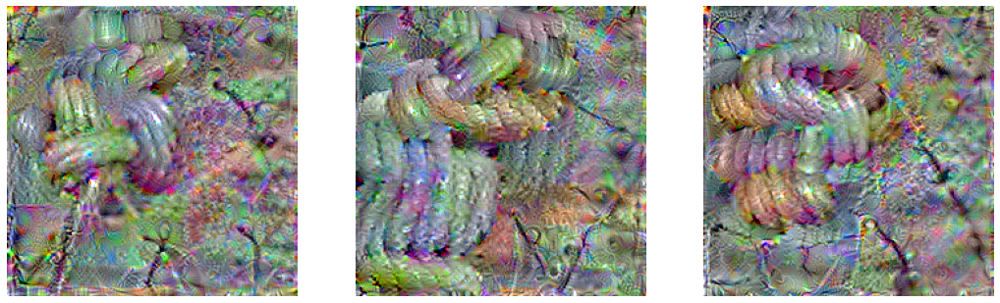

<Figure size 1728x432 with 0 Axes>

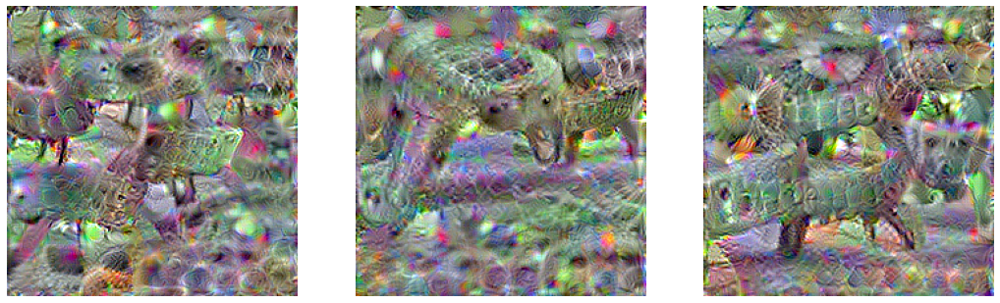

<Figure size 1728x432 with 0 Axes>

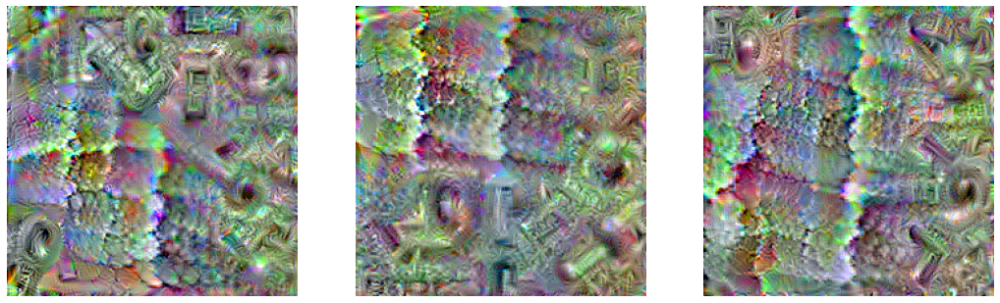

In [7]:
# It seems to work better if we occasionally remove info about the short length scales in the image, through blurring
# We're loosely following Deep Dream (https://www.tensorflow.org/tutorials/generative/deepdream)
# Swapping out image resizing for Gaussian blurring in order to get larger length scale features
layer_id = 148
mini_model = tf.keras.Model(resnet.input, resnet.layers[layer_id].output)

update_step_size = 1e-2
num_perturb_steps = 100
moment_power = 2

for kernel_id in range(3):
  images_adjusted = tf.Variable(tf.random.uniform((num_images, 224, 224, 3)))
  for sigma_id, sigma in enumerate([0, 5, 3, 1]):
    images_adjusted = tf.Variable(nim.filters.gaussian_filter(images_adjusted, [0, sigma, sigma, 0]))
    opt = tf.keras.optimizers.Adam(update_step_size)
    for update_step in range(num_perturb_steps):
      with tf.GradientTape() as tape:
        kernel_activation = mini_model(images_adjusted)[..., kernel_id]
        kernel_activation = tf.reshape(kernel_activation, [-1])
        kernel_activation_exp = tf.pow(kernel_activation, moment_power)
        loss = -tf.reduce_sum(tf.reduce_mean(kernel_activation_exp) - tf.pow(tf.reduce_mean(kernel_activation), moment_power))
      grads = np.float32(tape.gradient(loss, images_adjusted))
      opt.apply_gradients(zip([grads], [images_adjusted]))
      images_adjusted.assign(tf.clip_by_value(images_adjusted, 0., 1.))
    
  plt.figure(figsize=(num_images*inches_per_subplot, inches_per_subplot))
  for image_id in range(num_images):
    plt.subplot(1, num_images, image_id+1)
    plt.imshow(images_adjusted[image_id])
    plt.axis('off')
  plt.show()

In [ ]:
# The ResNet we downloaded was pre-trained on Imagenet, a classification task with 1000 classes

# The classes are listed here; look through and find interesting indices
# https://gist.github.com/yrevar/942d3a0ac09ec9e5eb3a#file-imagenet1000_clsidx_to_labels-txt

# Instead of maximizing these intermediate activations, which can encode multiple patterns (and be harder to interpret),
# let's maximize the predicted classification of a certain class

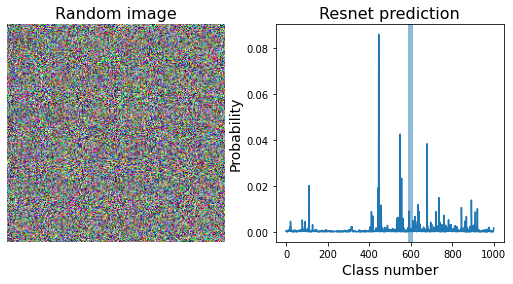

Predicted class num: 446


In [3]:
desired_class_index = 599  # honeycomb
hallucination_image = tf.Variable(tf.random.uniform((1, 224, 224, 3)))

model_predictions = resnet(hallucination_image)
plt.figure(figsize=(9, 4))
plt.subplot(121)
plt.imshow(hallucination_image[0])
plt.title('Random image', fontsize=16)
plt.axis('off')
plt.subplot(122)

plt.plot(model_predictions[0])
plt.axvspan(desired_class_index-10, desired_class_index+10, alpha=0.5)
plt.title('Resnet prediction', fontsize=16)
plt.xlabel('Class number', fontsize=14)
plt.ylabel('Probability', fontsize=14)
plt.show()
print('Predicted class num:', tf.argmax(model_predictions[0]).numpy())
# Random noise seems to often resonate with class 446: binder, ring-binder

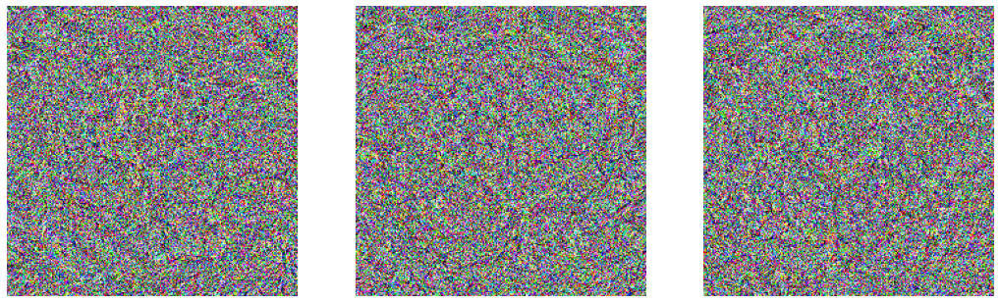

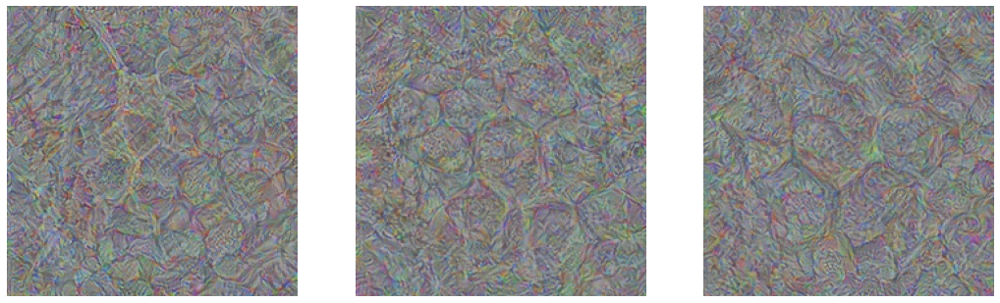

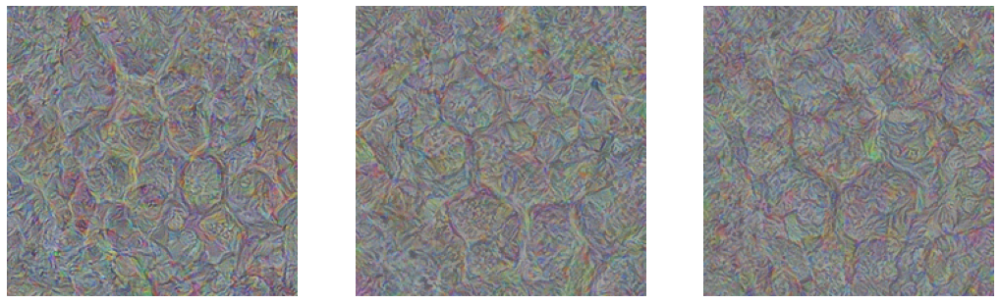

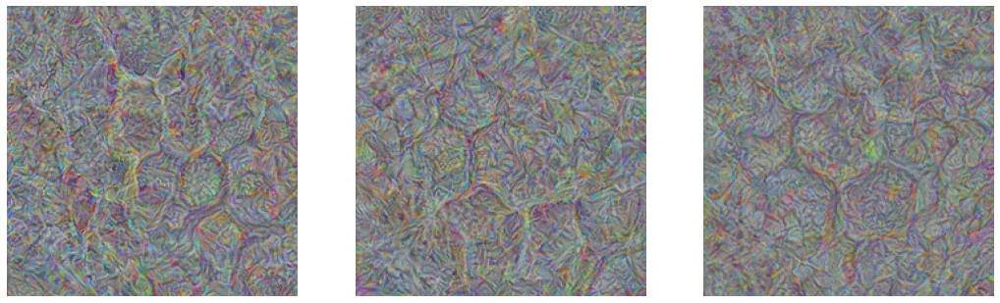

In [5]:
desired_class_index = 599  # honeycomb

num_steps_per_length_scale = 200
learning_rate = 1e-2
num_images = 3
inches_per_subplot = 6
hallucination_image = tf.Variable(tf.random.uniform((num_images, 224, 224, 3)))

for sigma in [0, 5, 3, 1]:
  hallucination_image = tf.Variable(nim.filters.gaussian_filter(hallucination_image, [0, sigma, sigma, 0]))
  opt = #TODO put in an SGD optimizer
  for step in range(num_steps_per_length_scale):
    with tf.GradientTape() as tape:
      preds = resnet(hallucination_image, training=False)
      loss = -tf.reduce_mean(preds[:, desired_class_index])
    grads = tape.gradient(loss, hallucination_image)
    grads /= tf.math.reduce_std(grads) + 1e-8
    opt.apply_gradients(zip([grads], [hallucination_image]))
    hallucination_image.assign(tf.clip_by_value(hallucination_image, 0., 1.))
  plt.figure(figsize=(num_images*inches_per_subplot, inches_per_subplot))
  for image_id in range(num_images):
    plt.subplot(1, num_images, image_id+1)
    plt.imshow(hallucination_image[image_id].numpy())
    plt.axis('off')
  plt.show()